# Прогнозирование оттока клиентов в сети отелей «Как в гостях»

Заказчик этого исследования — сеть отелей «Как в гостях».

Чтобы привлечь клиентов, эта сеть отелей добавила на свой сайт возможность забронировать номер без предоплаты. Однако если клиент отменял бронирование, то компания терпела убытки. Сотрудники отеля могли, например, закупить продукты к приезду гостя или просто не успеть найти другого клиента.

Чтобы решить эту проблему, вам нужно разработать систему, которая предсказывает отказ от брони. Если модель покажет, что бронь будет отменена, то клиенту предлагается внести депозит. Размер депозита — 80% от стоимости номера за одни сутки и затрат на разовую уборку. Деньги будут списаны со счёта клиента, если он всё же отменит бронь.

### Шаг 1. Откройте файлы с данными

In [1]:
pip install pandas_profiling

     |████████████████████████████████| 268 kB 2.6 MB/s eta 0:00:01
     |████████████████████████████████| 4.7 MB 50.8 MB/s eta 0:00:01
     |████████████████████████████████| 709 kB 78.0 MB/s eta 0:00:01
     |████████████████████████████████| 102 kB 77.3 MB/s eta 0:00:01
     |████████████████████████████████| 2.0 MB 64.8 MB/s eta 0:00:01
     |████████████████████████████████| 296 kB 90.8 MB/s eta 0:00:01
     |████████████████████████████████| 6.9 MB 57.7 MB/s eta 0:00:01
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27085 sha256=3d8614351c74c869e4d62cf55cc9036e05cc50d9f5b7236e99153e6b2623c34e
  Stored in directory: /home/jovyan/.cache/pip/wheels/1d/05/04/c6d7d3b66539d9e659ac6dfe81e2d0fd4c1a8316cc5a403300
Successfully built htmlmin
Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install imblearn

     |████████████████████████████████| 199 kB 2.7 MB/s eta 0:00:01
     |████████████████████████████████| 30.8 MB 27.1 MB/s eta 0:00:01
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 0.24.1
    Uninstalling scikit-learn-0.24.1:
      Successfully uninstalled scikit-learn-0.24.1
Note: you may need to restart the kernel to use updated packages.


In [3]:
import pandas as pd
import pandas_profiling
import numpy as np
import matplotlib.pyplot as plt
import calendar
import datetime as dt
import seaborn as sns

from scipy.stats import t

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.utils import shuffle
from sklearn.preprocessing import OneHotEncoder

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

from sklearn.compose import ColumnTransformer
from imblearn.pipeline import make_pipeline
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE, ADASYN


np.random.seed(1)

pd.options.display.float_format = '{:,.2f}'.format

In [4]:
df_train = pd.read_csv('/datasets/hotel_train.csv')
df_test =  pd.read_csv('/datasets/hotel_test.csv')

### Шаг 2. Предобработка и исследовательский анализ данных

In [5]:
pandas_profiling.ProfileReport(df_train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
pandas_profiling.ProfileReport(df_test)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Пропусков нет, а имеющийся нули в колонках объяснимы.

In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65229 entries, 0 to 65228
Data columns (total 25 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              65229 non-null  int64  
 1   is_canceled                     65229 non-null  int64  
 2   lead_time                       65229 non-null  float64
 3   arrival_date_year               65229 non-null  int64  
 4   arrival_date_month              65229 non-null  object 
 5   arrival_date_week_number        65229 non-null  int64  
 6   arrival_date_day_of_month       65229 non-null  int64  
 7   stays_in_weekend_nights         65229 non-null  int64  
 8   stays_in_week_nights            65229 non-null  int64  
 9   adults                          65229 non-null  float64
 10  children                        65229 non-null  float64
 11  babies                          65229 non-null  float64
 12  meal                            

adults, children, babies, lead_time необходимо перевести в int

Рассмотрим количественные характеристики на предмет наличия выбросов

In [8]:
print('Число дубликатов:',df_train.duplicated().sum())

Число дубликатов: 0


Дубликатов не обнаружено

id


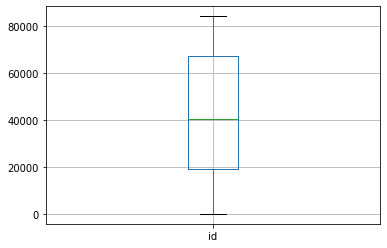

is_canceled


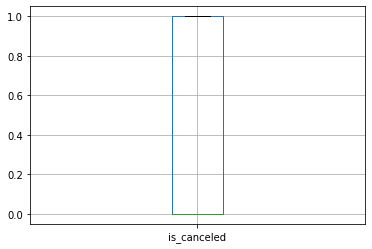

lead_time


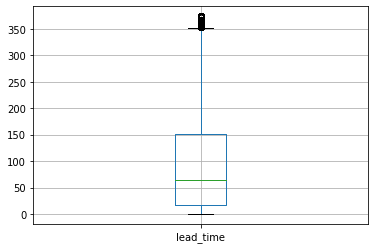

arrival_date_year


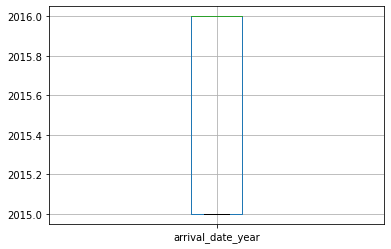

arrival_date_week_number


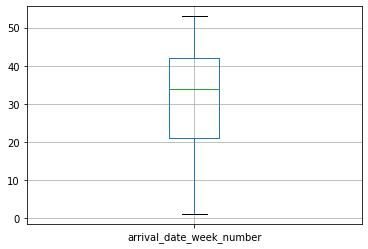

arrival_date_day_of_month


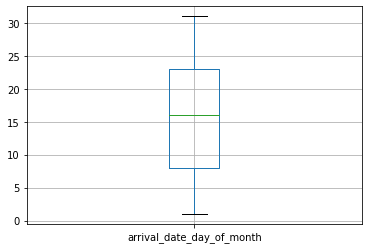

stays_in_weekend_nights


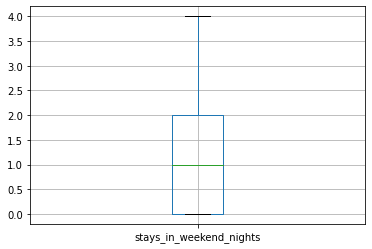

stays_in_week_nights


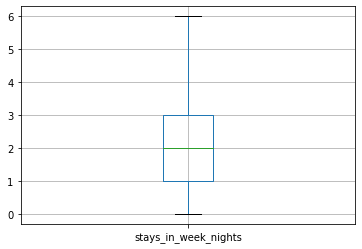

adults


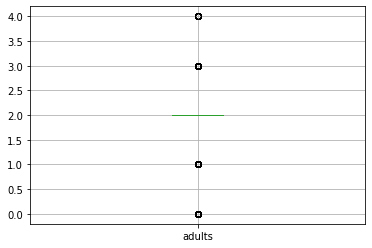

children


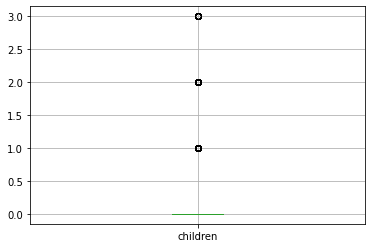

babies


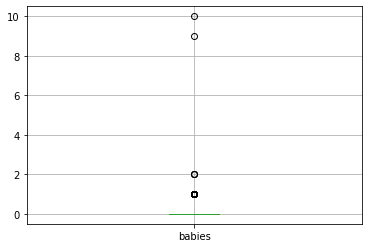

is_repeated_guest


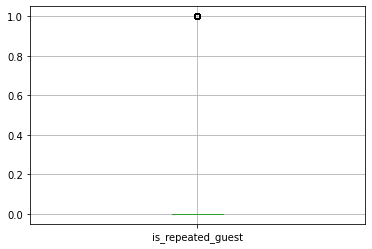

previous_cancellations


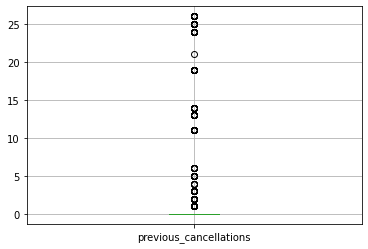

previous_bookings_not_canceled


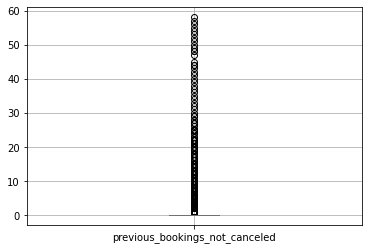

booking_changes


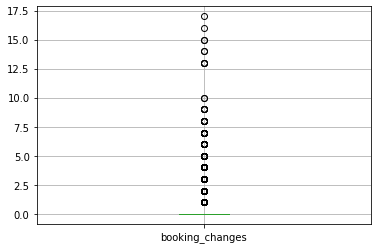

days_in_waiting_list


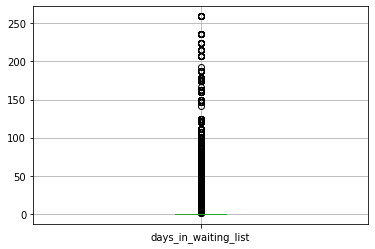

required_car_parking_spaces


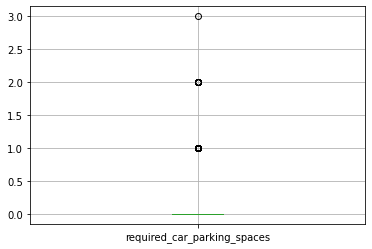

total_of_special_requests


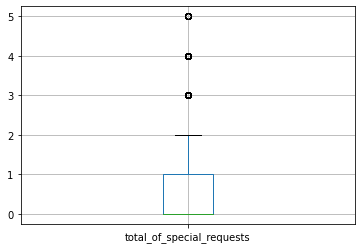

total_nights


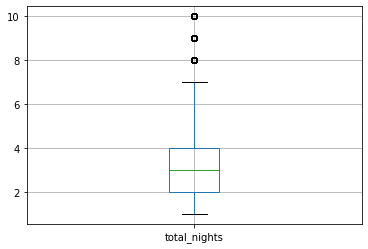

In [9]:
for i in df_train.columns:
    if df_train[i].dtype != object:
        print(i)
        df_train.boxplot(i)
        plt.show()

Есть случаи с 9-10 детьми, что скорее всего не соответствует действительности. 

Также имеются подозрительные выбросы в колонках lead_time, days_in_waiting_list. Эти характеристики необходимо рассмотреть дополнительно.

In [10]:
for i in ['lead_time', 'babies', 'days_in_waiting_list']:
    print(i)
    print(df_train[i].describe())
    print('')

lead_time
count   65,229.00
mean        96.34
std         96.13
min          0.00
25%         17.00
50%         64.00
75%        151.00
max        374.00
Name: lead_time, dtype: float64

babies
count   65,229.00
mean         0.01
std          0.10
min          0.00
25%          0.00
50%          0.00
75%          0.00
max         10.00
Name: babies, dtype: float64

days_in_waiting_list
count   65,229.00
mean         3.33
std         18.24
min          0.00
25%          0.00
50%          0.00
75%          0.00
max        259.00
Name: days_in_waiting_list, dtype: float64



In [11]:
df_train[df_train['days_in_waiting_list'] > 10]['is_canceled'].value_counts()

1    2010
0    1073
Name: is_canceled, dtype: int64

In [12]:
table_lead_cancel = df_train[(df_train['days_in_waiting_list'] >= 0) & (df_train['days_in_waiting_list'] < 4)]['is_canceled'].value_counts()
table_lead_cancel = pd.DataFrame(table_lead_cancel)
table_lead_cancel.columns = ['0-3']

for i in range(4, int(df_train['days_in_waiting_list'].max()), 10):
    buffer = df_train[(df_train['lead_time'] >= i) & (df_train['lead_time'] < i+10)]['is_canceled'].value_counts()
    buffer = pd.DataFrame(buffer)
    buffer.columns = [f'{i}-{i+10}']
    table_lead_cancel = table_lead_cancel.join([buffer])
table_lead_cancel = table_lead_cancel.T

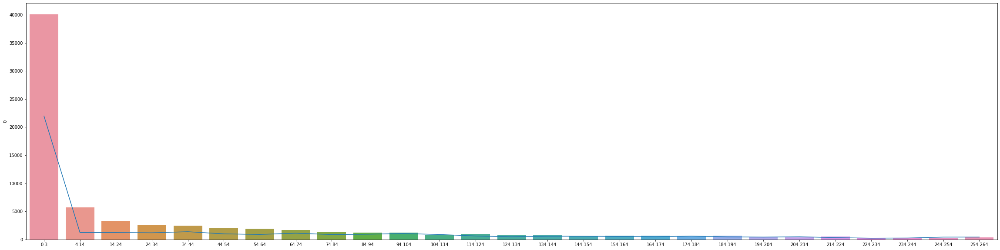

In [13]:
plt.figure(figsize=(40,10))
ax = sns.lineplot(data=table_lead_cancel, x=table_lead_cancel.index, y=table_lead_cancel[1])
show = sns.barplot(data=table_lead_cancel, x=table_lead_cancel.index, y=table_lead_cancel[0], ax=ax)

In [14]:
print('0-3')
print(df_train[(df_train['days_in_waiting_list'] >= 0) & (df_train['days_in_waiting_list'] < 4)]['is_canceled'].value_counts())
print()
print('4-10')
print( df_train[(df_train['days_in_waiting_list'] >= 4) & (df_train['days_in_waiting_list'] < 11)]['is_canceled'].value_counts())
print()
print('Более 10')
print(df_train[(df_train['days_in_waiting_list'] >= 11)]['is_canceled'].value_counts())

0-3
0    40085
1    21984
Name: is_canceled, dtype: int64

4-10
1    50
0    27
Name: is_canceled, dtype: int64

Более 10
1    2010
0    1073
Name: is_canceled, dtype: int64


Нахождения клиента в листе ожидания более 10 дней представляется маловероятным, однако полностью этого нельзя исключать.

Если разбить на промежутки по 10 дней данные из столба days_in_waiting_list видно, что соотношение использования и не использования номеров при бронировании в зависимости от количества дней ожидания постепенно растет в сторону не номеров.

С другой стороны, если клиент находится в листе ожиданий более 3х дней, то число случаев неиспользования номеров превосходит число клиентов, которые услугой фактически воспользовались, что безусловно логично.

In [15]:
table_lead_cancel = df_train[(df_train['lead_time'] >= 0) & (df_train['lead_time'] < 30)]['is_canceled'].value_counts()
table_lead_cancel = pd.DataFrame(table_lead_cancel)
table_lead_cancel.columns = ['0-30 | 1']

for i in range(30, int(df_train['lead_time'].max()), 30):
    buffer = df_train[(df_train['lead_time'] >= i) & (df_train['lead_time'] < i+30)]['is_canceled'].value_counts()
    buffer = pd.DataFrame(buffer)
    buffer.columns = [f'{i}-{i+30}| {(i+30)/30}']
    table_lead_cancel = table_lead_cancel.join([buffer])
table_lead_cancel = table_lead_cancel.T

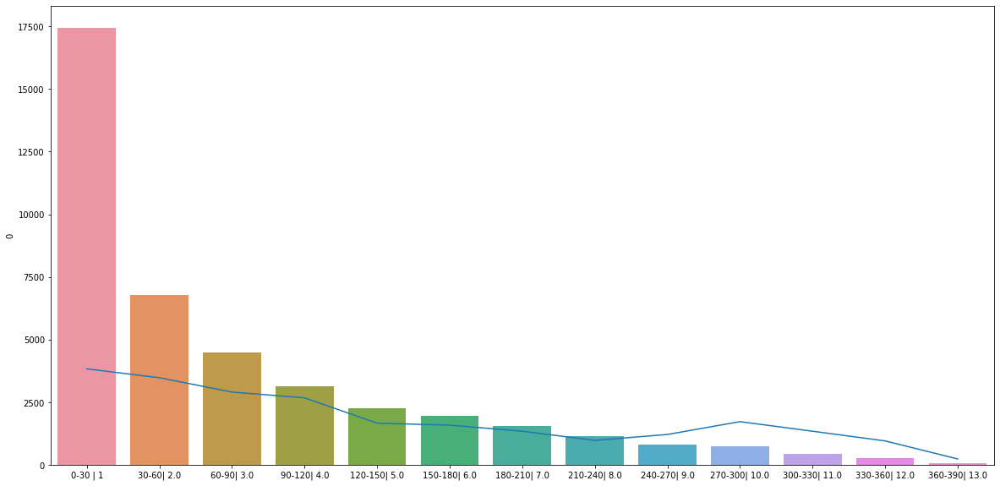

In [16]:
plt.figure(figsize=(20,10))
ax = sns.lineplot(data=table_lead_cancel, x=table_lead_cancel.index, y=table_lead_cancel[1])
show = sns.barplot(data=table_lead_cancel, x=table_lead_cancel.index, y=table_lead_cancel[0], ax=ax)

In [17]:
table_lead_cancel_60 = df_train[(df_train['lead_time'] > 60)]['is_canceled'].value_counts()

In [18]:
table_lead_cancel_60

0    16810
1    16626
Name: is_canceled, dtype: int64

Было бы неплохо знать предельный срок, с которого уже нельзя забронировать отель. А так представляется маловероятным бронирование отелей более чем за полгода (183 дня). С другой страны идет явное увеличение числа отмен (относительно числа не отменённой брони), что логично, клиент мог просто забыть, что забронировал отель. Так вероятность того, что клиент не воспользуется забронированным отелем при его брони более чем, через 60 дней составляет примерно 50%.

In [19]:
def preprocess(df): 
    'Удалим лишнии пробелы в объектах типо object'
    for i in df.select_dtypes(include = 'object').columns:
        df[i] = df[i].str.strip()
           
    'Уберем случаи с количеством младенцев более 3'
    df = df[df['babies'] < 4]
    
    'Изменим типы данных'
    for i in ['adults', 'children', 'babies', 'lead_time']:
        df[i] = df[i].astype('int')
    
    df.info()
    print(df[df['babies'] >= 4])
    return df

In [20]:
df_train = preprocess(df_train)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65227 entries, 0 to 65228
Data columns (total 25 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   id                              65227 non-null  int64 
 1   is_canceled                     65227 non-null  int64 
 2   lead_time                       65227 non-null  int64 
 3   arrival_date_year               65227 non-null  int64 
 4   arrival_date_month              65227 non-null  object
 5   arrival_date_week_number        65227 non-null  int64 
 6   arrival_date_day_of_month       65227 non-null  int64 
 7   stays_in_weekend_nights         65227 non-null  int64 
 8   stays_in_week_nights            65227 non-null  int64 
 9   adults                          65227 non-null  int64 
 10  children                        65227 non-null  int64 
 11  babies                          65227 non-null  int64 
 12  meal                            65227 non-null

/tmp/ipykernel_55/2842346998.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[i] = df[i].astype('int')


In [21]:
df_test = preprocess(df_test)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32412 entries, 0 to 32411
Data columns (total 25 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   id                              32412 non-null  int64 
 1   is_canceled                     32412 non-null  int64 
 2   lead_time                       32412 non-null  int64 
 3   arrival_date_year               32412 non-null  int64 
 4   arrival_date_month              32412 non-null  object
 5   arrival_date_week_number        32412 non-null  int64 
 6   arrival_date_day_of_month       32412 non-null  int64 
 7   stays_in_weekend_nights         32412 non-null  int64 
 8   stays_in_week_nights            32412 non-null  int64 
 9   adults                          32412 non-null  int64 
 10  children                        32412 non-null  int64 
 11  babies                          32412 non-null  int64 
 12  meal                            32412 non-null

In [22]:
df = pd.concat([df_train, df_test])

In [23]:
df_non = df[df['is_canceled'] == 1]
df_profit = df[df['is_canceled'] == 0]

In [24]:
df_non.describe()

,id,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,required_car_parking_spaces,total_of_special_requests,total_nights
count,"36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00","36,635.00"
mean,"37,979.73",1.00,132.77,"2,016.15",26.98,15.73,0.83,2.30,1.88,0.07,0.00,0.01,0.21,0.02,0.09,3.50,0.00,0.32,3.13
std,"17,525.11",0.00,99.85,0.72,13.20,8.74,0.85,1.29,0.45,0.34,0.05,0.12,1.24,0.71,0.44,17.23,0.00,0.64,1.64
min,4.00,1.00,0.00,"2,015.00",1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00
25%,"31,662.50",1.00,48.00,"2,016.00",17.00,8.00,0.00,1.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.00
50%,"41,891.00",1.00,109.00,"2,016.00",26.00,16.00,1.00,2.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,3.00
75%,"51,065.50",1.00,201.00,"2,017.00",38.00,23.00,2.00,3.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4.00
max,"96,165.00",1.00,374.00,"2,017.00",53.00,31.00,4.00,6.00,4.00,3.00,1.00,1.00,26.00,58.00,16.00,236.00,0.00,5.00,10.00


In [25]:
df_profit.describe()

,id,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,required_car_parking_spaces,total_of_special_requests,total_nights
count,"61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00","61,004.00"
mean,"55,698.65",0.00,75.12,"2,016.14",26.76,15.81,0.85,2.24,1.82,0.08,0.01,0.04,0.02,0.19,0.27,1.60,0.09,0.71,3.08
std,"31,203.65",0.00,81.38,0.70,14.10,8.76,0.85,1.40,0.50,0.34,0.09,0.19,0.29,1.85,0.68,13.83,0.28,0.82,1.80
min,0.00,0.00,0.00,"2,015.00",1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00
25%,"21,997.75",0.00,9.00,"2,016.00",15.00,8.00,0.00,1.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.00
50%,"67,360.50",0.00,45.00,"2,016.00",27.00,16.00,1.00,2.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,3.00
75%,"82,642.25",0.00,118.00,"2,017.00",39.00,23.00,2.00,3.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,4.00
max,"97,903.00",0.00,373.00,"2,017.00",53.00,31.00,4.00,6.00,4.00,3.00,2.00,1.00,13.00,72.00,18.00,259.00,8.00,5.00,10.00


Из анализа средних, квантилей количественных характеристик видно, что наибольшие значение имеет lead_time и days_in_waiting_list, их значения сильнее всего отличаются в случаях прибытия и не прибытия клиента в отель.

In [26]:
df_cancel_country = pd.pivot_table(df, index='country', values='is_canceled', aggfunc=['count', 'sum'])

In [27]:
df_cancel_country.columns = ['count', 'sum']

In [28]:
df_cancel_country['sum/count'] = df_cancel_country['sum'] / df_cancel_country['count'] 

In [29]:
df_cancel_country['relation_all'] = df_cancel_country['sum'] / len(df_non) 

In [30]:
df_cancel_country.sort_values(by='relation_all', ascending=False)[0:10]

,count,sum,sum/count,relation_all
country,,,,
PRT,38717,22497,0.58,0.61
GBR,9035,2007,0.22,0.05
FRA,9451,1733,0.18,0.05
ESP,6832,1695,0.25,0.05
ITA,3480,1258,0.36,0.03
DEU,6265,1114,0.18,0.03
BRA,1969,742,0.38,0.02
IRL,2505,647,0.26,0.02
USA,1782,431,0.24,0.01


In [31]:
df_cancel_country[(df_cancel_country['count'] > 500) & (df_cancel_country['sum/count'] > 0.3)].sort_values(by='sum/count', ascending=False)

,count,sum,sum/count,relation_all
country,,,,
PRT,38717,22497,0.58,0.61
CHN,921,429,0.47,0.01
BRA,1969,742,0.38,0.02
RUS,513,188,0.37,0.01
ITA,3480,1258,0.36,0.03


Из общего числа пропусков брони доля:
-	португальцев составляет 61% (58% от общего количества забронированных номеров указанной группы);
-	британцев составляет 5% (22% от общего количества забронированных номеров указанной группы);
-	французов составляет 5% (18% от общего количества забронированных номеров указанной группы);
-	испанцев составляет 5% (25% от общего количества забронированных номеров указанной группы).

При относительно низком вкладе в общее число пропусков граждане следующих государств имеют процент пропусков более 30 относительно общего числа посещений: Китай (47%), Россия (37%), Бразилия (38%), Италия (36%). 

In [32]:
df_cancel_distribution = pd.pivot_table(df, index='distribution_channel', 
                                        values='is_canceled', aggfunc=['count', 'sum'])

In [33]:
df_cancel_distribution.columns = ['count', 'sum']
df_cancel_distribution['sum/count'] = df_cancel_distribution['sum'] / df_cancel_distribution['count'] 
df_cancel_distribution['relation_all'] = df_cancel_distribution['sum'] / len(df_non) 

In [34]:
df_cancel_distribution.sort_values(by='relation_all', ascending=False)

,count,sum,sum/count,relation_all
distribution_channel,,,,
TA/TO,81536,33550,0.41,0.92
Direct,10495,1811,0.17,0.05
Corporate,5424,1241,0.23,0.03
GDS,184,33,0.18,0.00


Из общего числа пропусков брони по колонке distribution_channel доля TA/TO составляет 92% (25% от общего количества забронированных номеров указанной группы).

Необходимо рассмотреть распределение этого канала дистрибьюции по странам.

In [35]:
df_cancel_TATO = pd.pivot_table(df[df['distribution_channel'] =='TA/TO'], index=['country'], 
                                        values='is_canceled', aggfunc=['count', 'sum'])

In [36]:
df_cancel_TATO.columns = ['count', 'sum']

In [37]:
df_cancel_TATO['sum/count'] = df_cancel_TATO['sum'] / df_cancel_TATO['count'] 
df_cancel_TATO['relation_all'] = df_cancel_TATO['sum'] / len(df_non[df_non['distribution_channel'] == 'TA/TO']) 

In [38]:
df_cancel_TATO.sort_values(by='sum', ascending=False)

,count,sum,sum/count,relation_all
country,,,,
PRT,30096,20154,0.67,0.60
GBR,7651,1829,0.24,0.05
FRA,8380,1625,0.19,0.05
ESP,5785,1621,0.28,0.05
ITA,3153,1241,0.39,0.04
...,...,...,...,...
LAO,2,0,0.00,0.00
KNA,1,0,0.00,0.00
KIR,1,0,0.00,0.00


In [39]:
df_cancel_TATO[df_cancel_TATO['sum'] > 500].sort_values(by='sum/count', ascending=False)

,count,sum,sum/count,relation_all
country,,,,
PRT,30096,20154,0.67,0.60
BRA,1767,718,0.41,0.02
ITA,3153,1241,0.39,0.04
IRL,2138,604,0.28,0.02
ESP,5785,1621,0.28,0.05
GBR,7651,1829,0.24,0.05
FRA,8380,1625,0.19,0.05
DEU,5780,1079,0.19,0.03


In [40]:
df_cancel_country_TATO = df_cancel_country.merge(df_cancel_TATO, left_index = True, right_index = True, suffixes=('_country', '_TA/TO'))

In [41]:
df_cancel_country_TATO

,count_country,sum_country,sum/count_country,relation_all_country,count_TA/TO,sum_TA/TO,sum/count_TA/TO,relation_all_TA/TO
country,,,,,,,,
ABW,2,0,0.00,0.00,2,0,0.00,0.00
AGO,203,80,0.39,0.00,97,55,0.57,0.00
ALB,11,1,0.09,0.00,7,1,0.14,0.00
AND,2,2,1.00,0.00,2,2,1.00,0.00
ARE,37,33,0.89,0.00,36,32,0.89,0.00
...,...,...,...,...,...,...,...,...
VGB,1,1,1.00,0.00,1,1,1.00,0.00
VNM,8,2,0.25,0.00,8,2,0.25,0.00
ZAF,70,27,0.39,0.00,57,25,0.44,0.00


In [42]:
df_cancel_country_TATO.sort_values(by='sum_TA/TO', ascending=False)

,count_country,sum_country,sum/count_country,relation_all_country,count_TA/TO,sum_TA/TO,sum/count_TA/TO,relation_all_TA/TO
country,,,,,,,,
PRT,38717,22497,0.58,0.61,30096,20154,0.67,0.60
GBR,9035,2007,0.22,0.05,7651,1829,0.24,0.05
FRA,9451,1733,0.18,0.05,8380,1625,0.19,0.05
ESP,6832,1695,0.25,0.05,5785,1621,0.28,0.05
ITA,3480,1258,0.36,0.03,3153,1241,0.39,0.04
...,...,...,...,...,...,...,...,...
LAO,2,0,0.00,0.00,2,0,0.00,0.00
KNA,1,0,0.00,0.00,1,0,0.00,0.00
KIR,1,0,0.00,0.00,1,0,0.00,0.00


Как видно из представленных выше таблиц, жители тех стран, где активнее всего задействован TA/TO вносят наибольший вклад в число фактов неиспользования забронированных номеров.

Соотношение количества лиц, не воспользовавшихся отелем после его бронирования и количества лиц, привлеченных при помощи TA/TO у стран, жители которых внесли наибольший вклад в количество пропусков брони идентично.

Таким образом дело не в гражданстве клиента, а в способе его привлечения.

По результатам исследования данных выявлены следующие проблемы, которые решены на стадии предобработки:
- Есть случаи с 9-10 детьми, что скорее всего не соответствует действительности.
- adults, children, babies, lead_time необходимо перевести в int

Однако имеются спорные явления в колонках: 'days_in_waiting_list', 'lead_time'. Так как между предполагаемыми выбросами и случаями недобросовестного бронирования имеется связь и эта связь логична, то считаю необходимым не удалять указанные явления.

Исходя из исследовательского анализа данных можно сделать следующий вывод:
-	наибольшее влияние на то будет пропущена броня отеля или нет оказывает канал дистрибьюции, а именно клиенты, привлеченные при помощи TA/TO имеют наибольший шанс не воспользоваться отелем;
-	также имеет значение время нахождения клиента в листе ожидания и период времени, за который клиент забронировал отель.


### Шаг 3. Формулировка ML-задачи на основе бизнес-задачи

Рассчитаем прибыль (убытки) с одного факта бронирования

In [43]:
def date_time(df):
    'Создает отдельную колонку в формате datetime'
    
    def make_column(df):
        year = df['arrival_date_year']
        month = list(calendar.month_name).index(df['arrival_date_month']) 
        day = df['arrival_date_day_of_month']
        return f'{year}-{month}-{day}'
    
    df['date'] = df.apply(make_column, axis=1)
    df['date'] = pd.to_datetime(df['date'], format='%Y.%m.%d')
    return df

In [44]:
df_train = date_time(df_train)

/tmp/ipykernel_55/440246699.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = df.apply(make_column, axis=1)
/tmp/ipykernel_55/440246699.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = pd.to_datetime(df['date'], format='%Y.%m.%d')


In [45]:
df_train[['date', 'arrival_date_year', 'arrival_date_month', 'arrival_date_day_of_month']].sample(10)

,date,arrival_date_year,arrival_date_month,arrival_date_day_of_month
516,2015-07-31,2015,July,31
25817,2016-04-15,2016,April,15
62202,2016-10-29,2016,October,29
29820,2016-06-28,2016,June,28
19133,2015-09-08,2015,September,8
13956,2016-08-23,2016,August,23
31528,2016-08-20,2016,August,20
57042,2016-08-12,2016,August,12
63669,2016-11-24,2016,November,24
33152,2016-09-30,2016,September,30


Метод выполняется без ошибки.

In [46]:
df_test = date_time(df_test)

Создадим словари необходимые с расшифровкой стоимости категорий номеров, их обслуживания, а также сезонных коэффициентов.

In [47]:
cost_hotel = dict(zip(['A', 'B', 'C', 'D', 'E', 'F', 'G'], 
                      [1000, 800, 600, 550, 500, 450, 350]))

cost_cleanup = dict(zip(['A', 'B', 'C', 'D', 'E', 'F', 'G'], 
                      [400, 350, 350, 150, 150, 150, 150]))

month_coef = dict(zip(list(range(1, 13)),
                    [1, 1, 1.2, 1.2, 1.2, 1.4, 1.4, 1.4, 1.2, 1.2, 1.2, 1]))

In [48]:
cost_hotel

{'A': 1000, 'B': 800, 'C': 600, 'D': 550, 'E': 500, 'F': 450, 'G': 350}

In [49]:
cost_cleanup

{'A': 400, 'B': 350, 'C': 350, 'D': 150, 'E': 150, 'F': 150, 'G': 150}

In [50]:
month_coef

{1: 1,
 2: 1,
 3: 1.2,
 4: 1.2,
 5: 1.2,
 6: 1.4,
 7: 1.4,
 8: 1.4,
 9: 1.2,
 10: 1.2,
 11: 1.2,
 12: 1}

Создадим метод, который будет считать прибыль(убыток) с каждого бронирования

In [51]:
def profit_calculate(df):
    '''возращает списки с двумя элементами: прибылью(убытком), формулой по которой он подсчитан
       функция также учитывает смену сезона в процессе проживания в отеле''' 
    coef_cancel = -1 if df['is_canceled'] == 1 else 1
    live_time =  df['total_nights'] if df['is_canceled'] == 0 else 1
    cleaning = 1 if df['total_nights'] <= 1 or df['is_canceled'] == 1 else df['total_nights'] // 2
    cleaning += 1 if df['total_nights']%2 == 1 and df['is_canceled'] == 0 and df['total_nights'] > 1 else 0
    date_start = df['date']
    date_end = df['date'] + pd.Timedelta(days=live_time-1)
    cost_hotel_ = cost_hotel[df['reserved_room_type']] 
    cost_cleanup_ = cost_cleanup[df['reserved_room_type']]
    
    if date_start.month == date_end.month:
        return [coef_cancel*(live_time*cost_hotel_*month_coef[date_start.month]) - cost_cleanup_*cleaning, 
                f'{coef_cancel}*({live_time}*{cost_hotel_}*{month_coef[date_start.month]}) - {cost_cleanup_}*{cleaning}']
        
    else: 
        cost_first_month = (live_time - date_end.day)*cost_hotel_*month_coef[date_start.month]
        cost_second_month = date_end.day*cost_hotel_*month_coef[date_start.month]
        
        return [cost_first_month+cost_second_month - cost_cleanup_*cleaning,
                f'({live_time} - {date_end.day})*{cost_hotel_}*{month_coef[date_start.month]}+{date_end.day}*{cost_hotel_}*{month_coef[date_start.month]} - {cost_cleanup_}*{cleaning}']

In [52]:
df_train['profit'], df_train['formula'] = zip(*df_train.apply(profit_calculate, axis=1))

/tmp/ipykernel_55/575789040.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train['profit'], df_train['formula'] = zip(*df_train.apply(profit_calculate, axis=1))


In [53]:
df_train[['profit', 'formula', 'is_canceled', 'total_nights', 'date', 'reserved_room_type', ]].sample(20)

,profit,formula,is_canceled,total_nights,date,reserved_room_type
61403,"4,000.00",1*(4*1000*1.2) - 400*2,0,4,2016-10-16,A
17481,"2,400.00",1*(2*1000*1.4) - 400*1,0,2,2015-08-09,A
45257,"2,200.00",1*(3*1000*1) - 400*2,0,3,2016-01-02,A
47731,800.00,1*(1*1000*1.2) - 400*1,0,1,2016-03-11,A
38154,"-1,800.00",-1*(1*1000*1.4) - 400*1,1,1,2015-07-09,A
503,"-1,800.00",-1*(1*1000*1.4) - 400*1,1,1,2015-07-31,A
3998,"10,000.00",1*(10*1000*1.2) - 400*5,0,10,2016-05-22,A
25508,"4,800.00",1*(5*1000*1.2) - 400*3,0,5,2016-04-08,A
1552,"4,020.00",1*(7*550*1.2) - 150*4,0,7,2015-10-21,D
40351,"2,800.00",1*(3*1000*1.2) - 400*2,0,3,2015-10-06,A


Для разных номеров, сезонов и т.д. функция работает правильно. 

In [54]:
df_test['profit'], df_test['formula'] = zip(*df_test.apply(profit_calculate, axis=1))

In [55]:
print(df_train.shape, df_test.shape)

(65227, 28) (32412, 28)


In [56]:
df_train[['stays_in_weekend_nights','stays_in_week_nights']].columns

Index(['stays_in_weekend_nights', 'stays_in_week_nights'], dtype='object')

Уберем с датасетов колонки, которые не будут иметь смысла для модели, также необходимо выделить отдельно 'profit', чтобы предотвратить утечку данных.

In [57]:
def split_data(df):
    df_X = df.drop(columns=['id', 'date', 'profit', 'formula', 'is_canceled'], axis=0)
    df_y = df['is_canceled']
    df_profit = df['profit']
    df_extra = df[['id', 'date', 'formula']]
    
    return  df_X, df_y, df_profit, df_extra         

In [58]:
X_train, y_train, profit_train, extra_train = split_data(df_train)

In [59]:
X_train

,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,...,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,booking_changes,days_in_waiting_list,customer_type,required_car_parking_spaces,total_of_special_requests,total_nights
0,7,2015,July,27,1,0,1,1,0,0,...,0,0,0,A,0,0,Transient,0,0,1
1,14,2015,July,27,1,0,2,2,0,0,...,0,0,0,A,0,0,Transient,0,1,2
2,0,2015,July,27,1,0,2,2,0,0,...,0,0,0,C,0,0,Transient,0,0,2
3,9,2015,July,27,1,0,2,2,0,0,...,0,0,0,C,0,0,Transient,0,1,2
4,85,2015,July,27,1,0,3,2,0,0,...,0,0,0,A,0,0,Transient,0,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65224,23,2016,December,53,30,2,4,2,0,0,...,0,0,0,D,0,0,Transient,0,2,6
65225,53,2016,December,53,31,2,3,2,0,0,...,0,0,0,D,0,0,Transient,0,3,5
65226,7,2016,December,53,31,2,4,2,0,0,...,0,0,0,D,0,0,Transient,0,1,6
65227,17,2016,December,53,30,2,5,2,0,0,...,0,0,0,A,0,0,Transient,0,1,7


In [60]:
y_train

0        0
1        0
2        0
3        0
4        1
        ..
65224    0
65225    0
65226    0
65227    0
65228    0
Name: is_canceled, Length: 65227, dtype: int64

In [61]:
profit_train

0        1,000.00
1        2,400.00
2        1,330.00
3        1,330.00
4       -1,800.00
           ...   
65224    2,850.00
65225    2,300.00
65226    2,850.00
65227    5,400.00
65228    5,400.00
Name: profit, Length: 65227, dtype: float64

In [62]:
extra_train

,id,date,formula
0,0,2015-07-01,1*(1*1000*1.4) - 400*1
1,1,2015-07-01,1*(2*1000*1.4) - 400*1
2,2,2015-07-01,1*(2*600*1.4) - 350*1
3,3,2015-07-01,1*(2*600*1.4) - 350*1
4,4,2015-07-01,-1*(1*1000*1.4) - 400*1
...,...,...,...
65224,84057,2016-12-30,(6 - 4)*550*1+4*550*1 - 150*3
65225,84063,2016-12-31,(5 - 4)*550*1+4*550*1 - 150*3
65226,84094,2016-12-31,(6 - 5)*550*1+5*550*1 - 150*3
65227,84117,2016-12-30,(7 - 5)*1000*1+5*1000*1 - 400*4


Метод работает правильно

In [63]:
X_test, y_test, profit_test, extra_test = split_data(df_test)

In [64]:
profit_test.sum()

35300770.0

Прибыль на тестовой выборке без учета дипозита 35 млн.

### Шаг 4. Разработка модели ML

Используем pipeline imbalancelearn, что позволит протестировать несколько моделей, несколько способов борьбы с дисбалансом классов.

In [65]:
categorical_feature = [ 'arrival_date_month', 'meal', 'country',
                      'distribution_channel', 'reserved_room_type', 'customer_type'
                     ]

numeric_feature = list(set(X_train.columns) - set(categorical_feature))


numeric_transformer = Pipeline(steps=[
    ("scaler", StandardScaler())
])

categorical_transformer = OneHotEncoder(handle_unknown="ignore")

preprocessor = ColumnTransformer(transformers=[
    ("num_transform", numeric_transformer, numeric_feature),
    ("cat_transform", categorical_transformer, categorical_feature)    
])


pipeline = Pipeline([('preprocessor', preprocessor), 
                    ('ros', RandomOverSampler()), 
                    ('clf', LogisticRegression())])
pipeline                     

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num_transform',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['is_repeated_guest',
                                                   'adults',
                                                   'previous_bookings_not_canceled',
                                                   'arrival_date_year',
                                                   'previous_cancellations',
                                                   'stays_in_week_nights',
                                                   'stays_in_weekend_nights',
                                                   'days_in_waiting_list',
                                                   'required_car_parking_spaces',
                                                   'babies',
                                                   'arr...date_week_number',
                                                   'arrival_date_day_of_month',
                                                   'total_nights',
                                                   'booking_changes',
                                                   'total_of_special_requests',
                                                   'lead_time', 'children']),
                                                 ('cat_transform',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['arrival_date_month', 'meal',
                                                   'country',
                                                   'distribution_channel',
                                                   'reserved_room_type',
                                                   'customer_type'])])),
                ('ros', RandomOverSampler()), ('clf', LogisticRegression())])

Я перебрал для случайного дерева значительно больший диапозон параметров у себя на компьютере, потому что так быстрее, здесь при задании параметров GridSearchCV у дерева выставил сразу лучшие из найденных мной параметров.

Исходя из моей задачи мне стоит ориентироваться только на метрику полноты, но если не подходить формально, а учитывать, то что требование о внесении депозита может также отпугнуть клиентов, то метрика f1 представляется более адекватной с точки зрения бизнеса, поэтому при первоначальном выборе моделей буду использовать ее.

In [66]:
param = [  {"clf": [LogisticRegression()],
          'ros':['passthrough', RandomOverSampler(), SMOTE(), ADASYN()]},
         {"clf__n_estimators": [300],
          'clf__max_depth': [10],
          "clf": [RandomForestClassifier()],
          'ros':['passthrough', RandomOverSampler(), SMOTE(), ADASYN()]},
        ]                                   
                                       
grid_search = GridSearchCV(pipeline, param, cv=5, n_jobs=-1, 
                            scoring=['f1', 'roc_auc', 'accuracy', 'precision', 'recall'],
                           refit='f1')
grid_search.fit(X_train, y_train)

/opt/conda/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _che

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num_transform',
                                                                         Pipeline(steps=[('scaler',
                                                                                          StandardScaler())]),
                                                                         ['is_repeated_guest',
                                                                          'adults',
                                                                          'previous_bookings_not_canceled',
                                                                          'arrival_date_year',
                                                                          'previous_cancellations',
                                                                          'stays_in_week_nights',
                                                                          'stays_in_weekend_nights',
                                                                          'days_in_waiting_list',
                                                                          'required_car_p...
             n_jobs=-1,
             param_grid=[{'clf': [LogisticRegression()],
                          'ros': ['passthrough', RandomOverSampler(), SMOTE(),
                                  ADASYN()]},
                         {'clf': [RandomForestClassifier(max_depth=10,
                                                         n_estimators=300)],
                          'clf__max_depth': [10], 'clf__n_estimators': [300],
                          'ros': ['passthrough', RandomOverSampler(), SMOTE(),
                                  ADASYN()]}],
             refit='f1',
             scoring=['f1', 'roc_auc', 'accuracy', 'precision', 'recall'])

In [67]:
print("Лучшие параметры:")
print(grid_search.best_params_)
print("Лучшая метрика на валидационных данных:")
print(grid_search.best_score_)

Лучшие параметры:
{'clf': RandomForestClassifier(max_depth=10, n_estimators=300), 'clf__max_depth': 10, 'clf__n_estimators': 300, 'ros': SMOTE()}
Лучшая метрика на валидационных данных:
0.5375024528142719


<div class="alert alert-info">
    Посчитал эту метрику перед подсчетом прибыли
</div>

In [68]:
col = ['params', 'mean_test_f1', 'mean_test_roc_auc', 'mean_test_accuracy', 'mean_test_precision', 'mean_test_recall']

In [69]:
pd.DataFrame(grid_search.cv_results_, columns=col).sort_values(by='mean_test_f1', ascending=False)

,params,mean_test_f1,mean_test_roc_auc,mean_test_accuracy,mean_test_precision,mean_test_recall
6,"{'clf': RandomForestClassifier(max_depth=10, n...",0.54,0.71,0.66,0.57,0.55
7,"{'clf': RandomForestClassifier(max_depth=10, n...",0.54,0.70,0.64,0.53,0.58
5,"{'clf': RandomForestClassifier(max_depth=10, n...",0.52,0.68,0.64,0.54,0.54
3,"{'clf': LogisticRegression(), 'ros': ADASYN()}",0.52,0.69,0.60,0.48,0.59
2,"{'clf': LogisticRegression(), 'ros': SMOTE()}",0.51,0.70,0.62,0.51,0.56
1,"{'clf': LogisticRegression(), 'ros': RandomOve...",0.51,0.69,0.62,0.50,0.56
4,"{'clf': RandomForestClassifier(max_depth=10, n...",0.48,0.69,0.70,0.67,0.43
0,"{'clf': LogisticRegression(), 'ros': 'passthro...",0.48,0.70,0.66,0.56,0.48


Параметров много, скорее всего какие-то из них только мешают делать предсказания, поэтому необходимо узнать вес каждого параметра датасета уже в обученной модели

In [70]:
clf = grid_search.best_estimator_._final_estimator

In [71]:
pipeline[0].fit(X_train)

ColumnTransformer(transformers=[('num_transform',
                                 Pipeline(steps=[('scaler', StandardScaler())]),
                                 ['is_repeated_guest', 'adults',
                                  'previous_bookings_not_canceled',
                                  'arrival_date_year', 'previous_cancellations',
                                  'stays_in_week_nights',
                                  'stays_in_weekend_nights',
                                  'days_in_waiting_list',
                                  'required_car_parking_spaces', 'babies',
                                  'arrival_date_week_number',
                                  'arrival_date_day_of_month', 'total_nights',
                                  'booking_changes',
                                  'total_of_special_requests', 'lead_time',
                                  'children']),
                                ('cat_transform',
                                 OneHotEncoder(handle_unknown='ignore'),
                                 ['arrival_date_month', 'meal', 'country',
                                  'distribution_channel', 'reserved_room_type',
                                  'customer_type'])])

In [72]:
std = np.std([tree.feature_importances_ for tree in clf.estimators_], axis=0)
feature_importances = pd.Series(clf.feature_importances_, index=list(pipeline[0].get_feature_names_out()))

In [73]:
feature_importances[feature_importances>0.03]

num_transform__previous_cancellations        0.11
num_transform__required_car_parking_spaces   0.05
num_transform__booking_changes               0.05
num_transform__total_of_special_requests     0.12
num_transform__lead_time                     0.12
cat_transform__country_PRT                   0.19
cat_transform__distribution_channel_TA/TO    0.03
dtype: float64

Модель обращает все-таки большее внимание на страну, чем на способ дистрибьюцию.

Обучим модель на признаках вес которых больше 0.03

In [74]:
columns = ['country', 'distribution_channel', 'customer_type', 'total_of_special_requests', 'previous_cancellations', 'lead_time', 'required_car_parking_spaces', 'booking_changes']

In [75]:
categorical_feature = ['country', 'distribution_channel', 'customer_type']

X_train_second, X_test_second = X_train[columns], X_test[columns]

categorical_transformer = OneHotEncoder(handle_unknown="ignore")

preprocessor = ColumnTransformer(transformers=[("cat_transform", categorical_transformer, categorical_feature)],
                                 remainder='passthrough'
                                )


pipeline_second = Pipeline([('preprocessor', preprocessor), 
                    ('ros', ADASYN()), 
                    ('clf', RandomForestClassifier())])
pipeline_second

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat_transform',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['country',
                                                   'distribution_channel',
                                                   'customer_type'])])),
                ('ros', ADASYN()), ('clf', RandomForestClassifier())])

In [76]:
param = [ {"clf__n_estimators": [250],
          'clf__max_depth': [10]
          }
        ]                                   
                                       
grid_search_second = GridSearchCV(pipeline_second, param, cv=5, n_jobs=-1, 
                            scoring=['f1', 'roc_auc', 'accuracy', 'precision', 'recall'],
                           refit='f1')
grid_search_second.fit(X_train_second, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('cat_transform',
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['country',
                                                                          'distribution_channel',
                                                                          'customer_type'])])),
                                       ('ros', ADASYN()),
                                       ('clf', RandomForestClassifier())]),
             n_jobs=-1,
             param_grid=[{'clf__max_depth': [10], 'clf__n_estimators': [250]}],
             refit='f1',
             scoring=['f1', 'roc_auc', 'accuracy', 'precision', 'recall'])

In [77]:
print("Лучшие параметры:")
print(grid_search_second.best_params_)
print("Лучшая метрика на валидационных данных:")
print(grid_search_second.best_score_)

Лучшие параметры:
{'clf__max_depth': 10, 'clf__n_estimators': 250}
Лучшая метрика на валидационных данных:
0.7045777442728042


In [78]:
pd.DataFrame(grid_search_second.cv_results_, columns=col)

,params,mean_test_f1,mean_test_roc_auc,mean_test_accuracy,mean_test_precision,mean_test_recall
0,"{'clf__max_depth': 10, 'clf__n_estimators': 250}",0.70,0.86,0.77,0.66,0.76


На валидационной выборке метрика recall модели, работающий с уменьшенным числом данных лучше, также необходимо сравнить значения этой метрики на тестовых данных.

In [79]:
clf = grid_search_second.best_estimator_._final_estimator

In [80]:
pipeline_second[0].fit(X_train_second)
std = np.std([tree.feature_importances_ for tree in clf.estimators_], axis=0)
feature_importances = pd.Series(clf.feature_importances_, index=list(pipeline_second[0].get_feature_names_out()))

In [81]:
feature_importances[feature_importances>0.01]

cat_transform__country_DEU                      0.02
cat_transform__country_FRA                      0.03
cat_transform__country_GBR                      0.01
cat_transform__country_PRT                      0.20
cat_transform__distribution_channel_Corporate   0.01
cat_transform__distribution_channel_Direct      0.03
cat_transform__distribution_channel_TA/TO       0.04
cat_transform__customer_type_Transient          0.05
cat_transform__customer_type_Transient-Party    0.05
remainder__total_of_special_requests            0.13
remainder__previous_cancellations               0.11
remainder__lead_time                            0.11
remainder__required_car_parking_spaces          0.08
remainder__booking_changes                      0.06
dtype: float64

Модель продолжает считать страну происхождения более важным фактором, чем канал привлечения клиентов, попробуем построить модель без country

In [82]:
columns = ['distribution_channel', 'customer_type', 'total_of_special_requests', 'previous_cancellations', 'lead_time', 'required_car_parking_spaces', 'booking_changes']

In [83]:
categorical_feature = ['distribution_channel', 'customer_type']

X_train_third, X_test_third = X_train[columns], X_test[columns]

categorical_transformer = OneHotEncoder(handle_unknown="ignore")

preprocessor = ColumnTransformer(transformers=[("cat_transform", categorical_transformer, categorical_feature)],
                                 remainder='passthrough'
                                )


pipeline_third = Pipeline([('preprocessor', preprocessor), 
                    ('ros', ADASYN()), 
                    ('clf', RandomForestClassifier())])
pipeline_third

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('cat_transform',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['distribution_channel',
                                                   'customer_type'])])),
                ('ros', ADASYN()), ('clf', RandomForestClassifier())])

In [84]:
param = [ {"clf__n_estimators": [250],
          'clf__max_depth': [10]
          }
        ]                                   
                                       
grid_search_third = GridSearchCV(pipeline_third, param, cv=5, n_jobs=-1, 
                            scoring=['f1', 'roc_auc', 'accuracy', 'precision', 'recall'],
                           refit='f1')
grid_search_third.fit(X_train_third, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('cat_transform',
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['distribution_channel',
                                                                          'customer_type'])])),
                                       ('ros', ADASYN()),
                                       ('clf', RandomForestClassifier())]),
             n_jobs=-1,
             param_grid=[{'clf__max_depth': [10], 'clf__n_estimators': [250]}],
             refit='f1',
             scoring=['f1', 'roc_auc', 'accuracy', 'precision', 'recall'])

In [85]:
print("Лучшие параметры:")
print(grid_search_third.best_params_)
print("Лучшая метрика на валидационных данных:")
print(grid_search_third.best_score_)

Лучшие параметры:
{'clf__max_depth': 10, 'clf__n_estimators': 250}
Лучшая метрика на валидационных данных:
0.6358603403033914


In [86]:
clf = grid_search_third.best_estimator_._final_estimator
pipeline_third[0].fit(X_train_third)
std = np.std([tree.feature_importances_ for tree in clf.estimators_], axis=0)
feature_importances = pd.Series(clf.feature_importances_, index=list(pipeline_third[0].get_feature_names_out()))
feature_importances[feature_importances>0.01]

cat_transform__distribution_channel_Direct     0.02
cat_transform__distribution_channel_TA/TO      0.04
cat_transform__customer_type_Contract          0.01
cat_transform__customer_type_Transient         0.07
cat_transform__customer_type_Transient-Party   0.05
remainder__total_of_special_requests           0.20
remainder__previous_cancellations              0.19
remainder__lead_time                           0.21
remainder__required_car_parking_spaces         0.09
remainder__booking_changes                     0.10
dtype: float64

По весам модель TA/TO практически игнорирует... по сути дела мои модели противоречат выводам, сделанных при исследовательском анализе данных.

<div class="alert alert-info">
    Здесь я считаю, что модель работает все таки не правильно. Как мне заставить модель обращать большее внимание на способ дистрибьюции?
</div>

<div class="alert alert-info">
    Посчитаем метрику f1 для лучшей модели
</div>

In [87]:
f1_score(y_test, grid_search_second.best_estimator_.predict(X_test))

0.6799664174629193

Посчитаем финансовую выгоду от работы второй модели (с уменьшенным числом фичей, но со странами), как самой эффективной на валидационных данных.

In [88]:
predict_second = grid_search_second.predict(X_test)

In [89]:
final_data = pd.DataFrame({'predict':predict_second, 'y_test':y_test, 'profit_test':profit_test})

In [90]:
final_data_sort = final_data[(final_data['predict'] == 1) & (final_data['y_test'] == 1)]

In [91]:
final_data_sort[final_data_sort['predict'] < 0].shape

(0, 3)

In [92]:
coef = 0.8
costs = 40 * (10**4)

In [93]:
profit = profit_test.sum()
profit_model = abs(final_data_sort['profit_test'].sum() * coef) - costs

print('Прибыль без учета дипозита:', )
print('Сумма полученная с депозитов не прибывших в отель клиентов, рассчитанная на основе тестовых данных (с учетом затрат на разработку и внедрение модели):', profit_model)
print('Прибыль с учетом дипозита:', profit + profit_model)
print('Прирост прибыльности в процентах:', profit_model*100 / (profit + profit_model)
     )

Прибыль без учета дипозита:
Сумма полученная с депозитов не прибывших в отель клиентов, рассчитанная на основе тестовых данных (с учетом затрат на разработку и внедрение модели): 9511624.0
Прибыль с учетом дипозита: 44812394.0
Прирост прибыльности в процентах: 21.225431517896588


Итого прирост прибыли до 44.8 млн. руб., на 21 процент.

In [94]:
state = np.random.RandomState(12345)

In [95]:
def profit_percent(df):
    coef = 0.8
    costs = 40 * (10**4)
    
    columns=['mean_profit', 
            '2.5%_quantile_product', 'risk_of_loss(%)', 
            'confidence_interval']    
    
    list_sum = []
    list_for_table = []
    
    for i in range(1000):
        df_sample = df.sample(n=len(df), random_state=state, replace=True)
        df_sample = df_sample[(df_sample['predict'] == 1) & (df_sample['y_test'] == 1)]
        list_sum.append(abs(df_sample['profit_test'].sum() * coef) - costs)
        
    list_sum = pd.Series(list_sum)    
    mean = list_sum.mean()
    quantile = list_sum.quantile(0.025)
    loss = len(list_sum[list_sum < 0])
    risk_of_loss = 0 if loss == 0 else loss*100/len(list_sum)
    confidence_interval = set([list_sum.quantile(0.025), list_sum.quantile(0.975)])
    
    list_for_table.append([mean, quantile, risk_of_loss, confidence_interval])
    print(f'Средняя прибыль: {mean}')
    print(f'Среднее значение 2.5% квантиль: {quantile}')
    print(f'Число убыточных разработки и развертывания модели: {loss}')
    print(f'Шанс убытков в %: {risk_of_loss}')
    print(f'Минимальная прибыль: {list_sum.min()}')
    print(f'Доверительный интервал: {confidence_interval}')
        
    return  pd.DataFrame(list_for_table, columns=columns)

In [96]:
table = profit_percent(final_data)

Средняя прибыль: 9515508.984
Среднее значение 2.5% квантиль: 9318540.6
Число убыточных разработки и развертывания модели: 0
Шанс убытков в %: 0
Минимальная прибыль: 9184000.0
Доверительный интервал: {9711992.8, 9318540.6}


In [97]:
table.T

,0
mean_profit,"9,515,508.98"
2.5%_quantile_product,"9,318,540.60"
risk_of_loss(%),0
confidence_interval,"{9711992.8, 9318540.6}"


В случае отсутствия существенных изменений в характеристиках клиентов совокупности внедрение модели будет себя окупать и приносить прибыль примерно на 9 млн. больше.

Исходя из исследовательского анализа данных можно сделать следующий вывод:
-	наибольшее влияние на то будет пропущена броня отеля или нет, оказывает канал дистрибьюции, а именно клиенты, привлеченные при помощи TA/TO чаще всего не пользовались отелем (41%);
-	также имеет значение время нахождения клиента в листе ожидания и насколько заранее клиент забронировал номер. Так, по имеющимся данным, если клиент пробыл в листе ожидания более 3 дней или забронировал номер более чем за 60 дней, то клиент не пользовался номером в 60% и 50% процентов случаев соответственно.


### Шаг 6. Напишите общий вывод

Исходя из исследовательского анализа данных можно сделать следующий вывод:
-	наибольшее влияние на то будет пропущена броня отеля или нет, оказывает канал дистрибьюции, а именно клиенты, привлеченные при помощи TA/TO чаще всего не пользовались отелем (41%);
-	также имеет значение время нахождения клиента в листе ожидания и насколько заранее клиент забронировал номер. Так, по имеющимся данным, если клиент пробыл в листе ожидания более 3 дней или забронировал номер более чем за 60 дней, то клиент не пользовался номером в 60% и 50% процентов случаев соответственно.

Для снижения числа случаев неиспользования номеров в случае бронирования рекомендуется:
-	развивать другие пути привлечения клиентов помимо TA/TO;
-	обязать персонал обслуживать заявки клиентов в наиболее короткий срок;
-	ограничить срок, за который клиент может бронировать отель 60-90 сутками и/или обязать персонал связываться с клиентом за месяц до его предполагаемого прибытия.

Также обучена модель машинного обучения, которая, на предоставленных данных, предсказывает 67% случаев, при которых клиент в случае бронирования номера, последним не пользовался. Внесение в такх случаях дипозита увеличило бы прибыль на 9.5 млн. (21.2%) до 44.8 млн.